In [1]:
from preprocessing import *

## Animal Detection
### W281 Final Project
#### Sayyed Jilani, Mike Christenon, Richard Shim

### Introduction

[Here](https://www.kaggle.com/datasets/alessiocorrado99/animals10) is the link to the source data-set from Kaggle. and [here](www.google.com) is a link to the proposal.

The data set consists of about 28k images of animals belonging to 10 different categories including dog, cat, horse, spider, butterfly, chicken, sheep, cow and squirrel. While the majority of the data was collected from google images and verified with a human label check, there is some unknown amount of erroneous, mislabeled data added to simulate real-world conditions.

### Load and Filter
First we will load the raw dataframe of all images, display a few examples of each of the classes and then filter out rows that have been identified to have erroneous data (e.g. clearly mislabeled).

The sample of images highlight a few things about the images:
- they are not of the same scale
- quality of image itself varies
- the posiitioning of the animals vary
- some images only provide a partial view of the animal in question
- some images contain multiple animals in the frame
- some images contain noise in the form of text or logos

Manual inspection of images has shown instances of completely incorrect image or images containing multiple labels but only classified as one. These images will be removed.

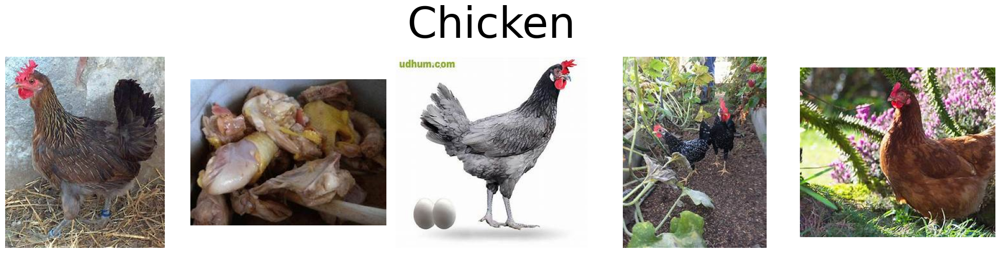

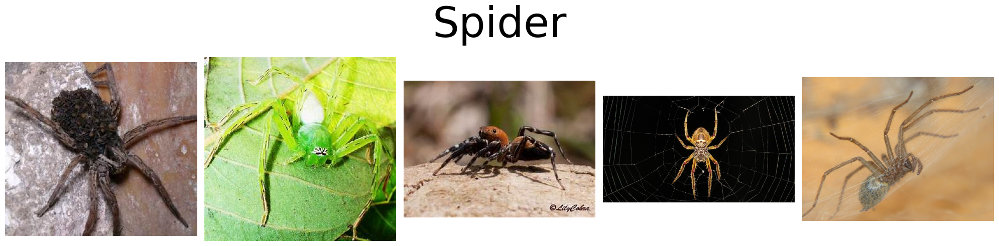

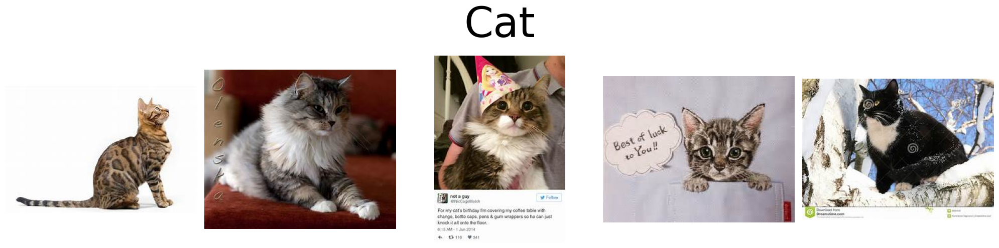

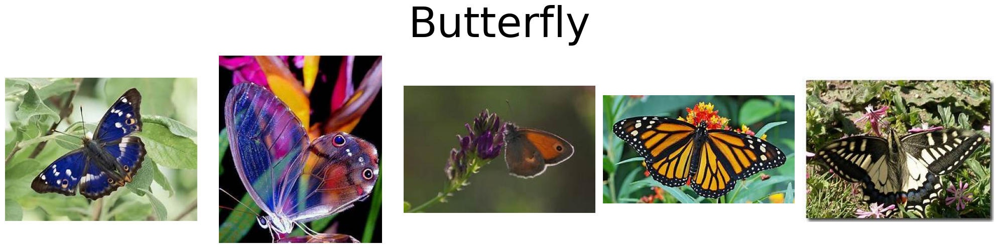

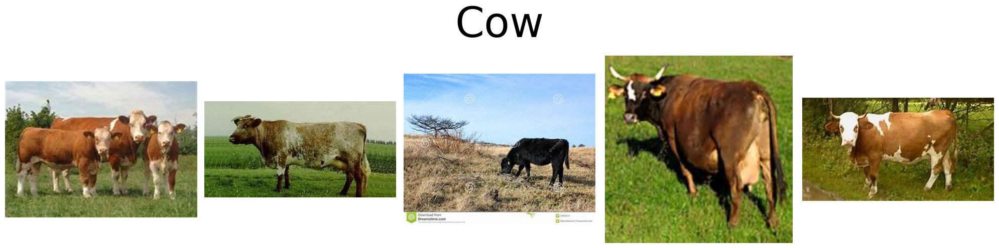

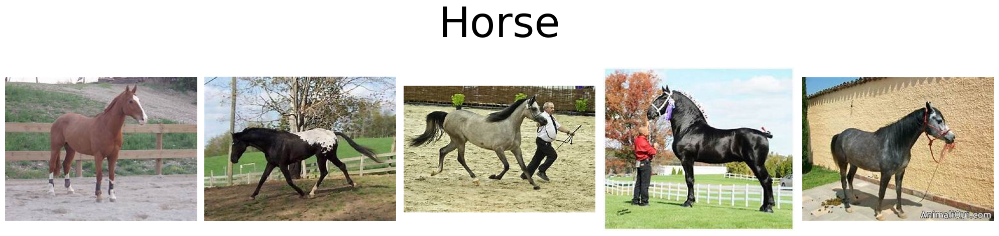

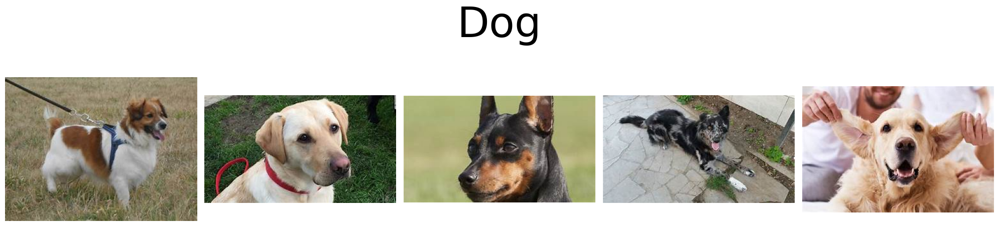

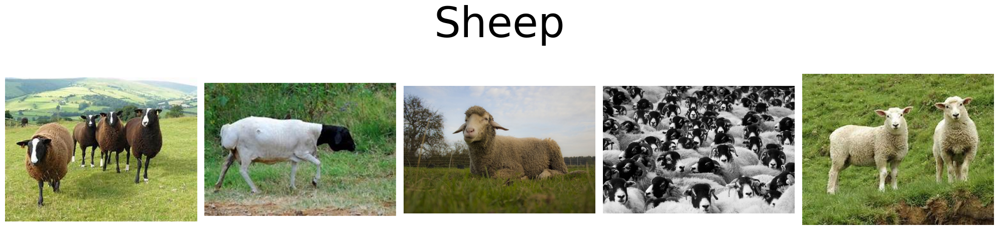

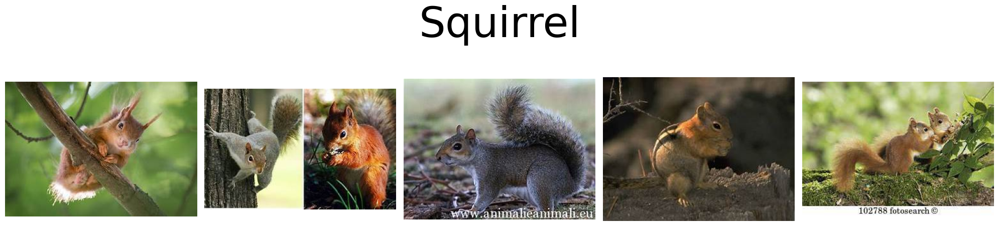

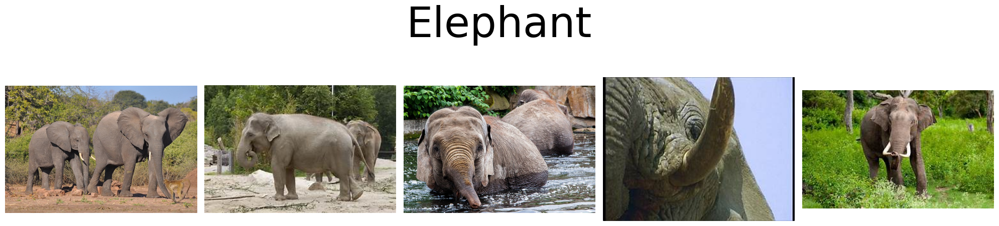

In [4]:
raw_file_df = load_raw_dataframe()
show_class_samples(raw_file_df)

In [5]:
file_df = filter_mislabeled_images(raw_file_df)

Raw class counts: label_name
butterfly    2112
cat          1668
chicken      3098
cow          1866
dog          4863
elephant     1446
horse        2623
sheep        1820
spider       4821
squirrel     1862
Name: file_name, dtype: int64

Filtered Class Counts: label_name
butterfly    2033
cat          1629
chicken      2961
cow          1776
dog          4829
elephant     1431
horse        2607
sheep        1686
spider       4650
squirrel     1772
Name: file_name, dtype: int64

Dropped Rows: label_name
butterfly     79
cat           39
chicken      137
cow           90
dog           34
elephant      15
horse         16
sheep        134
spider       171
squirrel      90
Name: file_name, dtype: int64


## Down-Sample

In order to streamline the initial feature development process and avoid biasing towards over represented classes in the data set we chose to down-sample our data set so all classes have the same count as the minority class. Elephants are the minority class in the filtered data set with a total of 1431 rows.

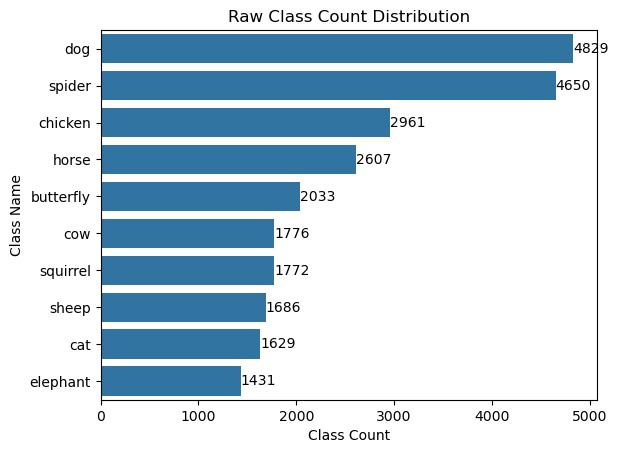

In [6]:
draw_class_counts(file_df, 'Raw Class Count Distribution')

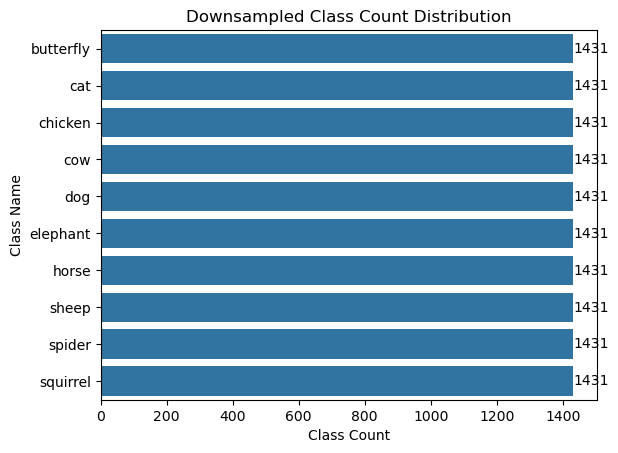

In [8]:
sample_df = down_sample(file_df)
draw_class_counts(sample_df, 'Downsampled Class Count Distribution')

# Feature Extraction (35 pts)

### Simple Feature 1 - Histogram of Gradients (HOG)

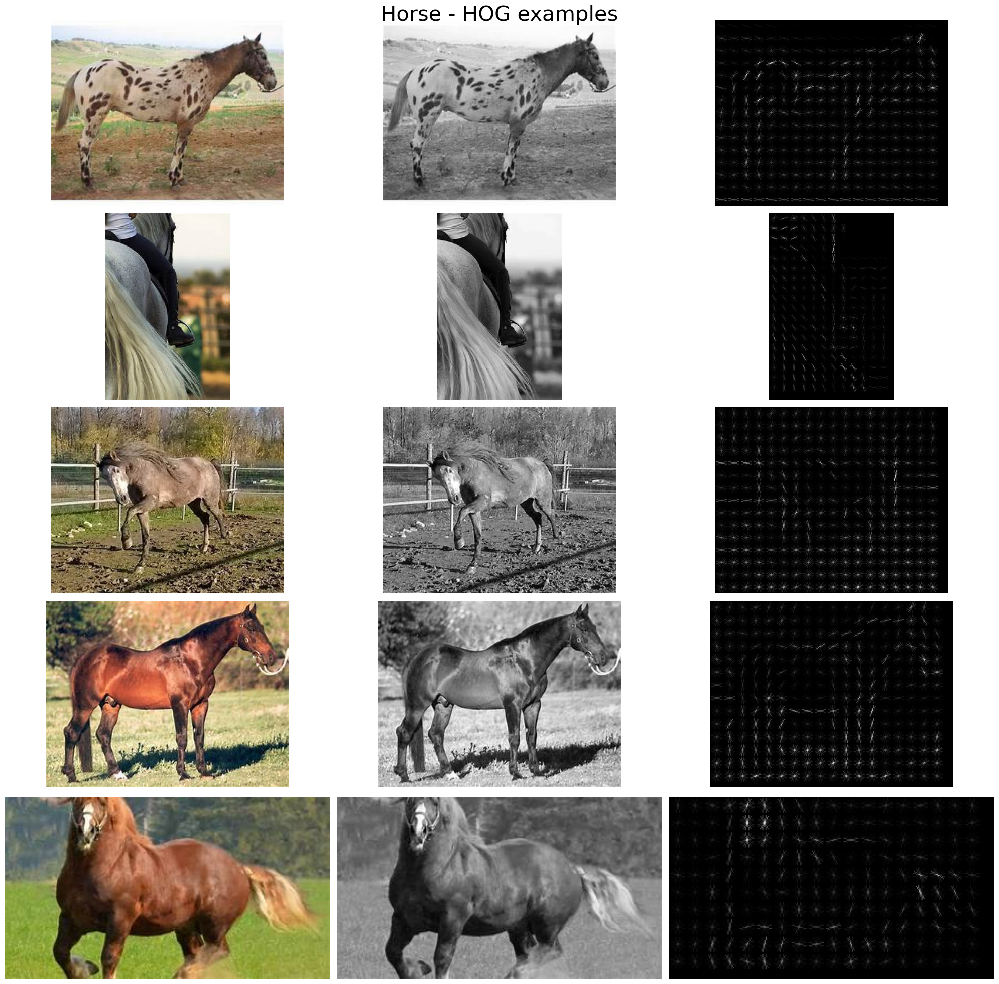

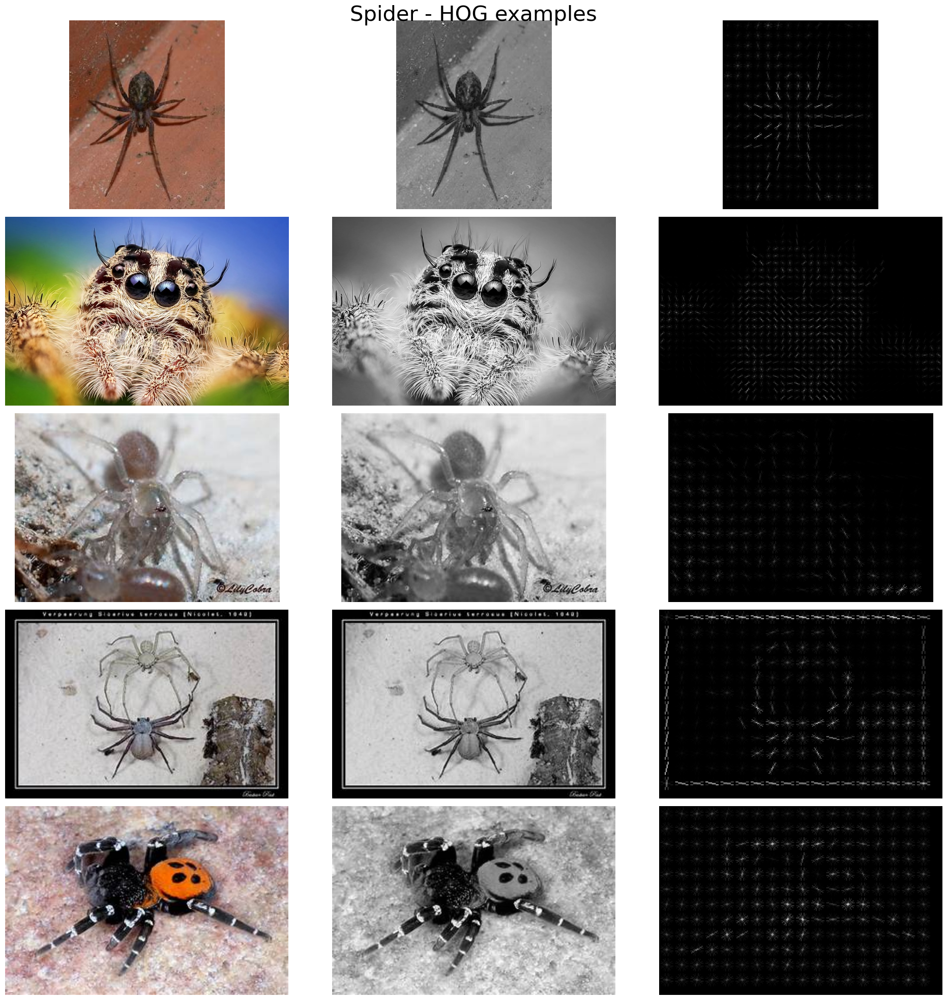

In [9]:
def show_hog_transform_examples(label_name, n_examples=5):
    """"""
    example_images = sample_df[sample_df.label_name == label_name].sample(n_examples, random_state=12345)['img_path'].to_list()
    fig, ax = plt.subplots(nrows=n_examples, ncols=3, figsize=(20, 20))
    for example in range(n_examples):
        example_img = load_img_rgb(example_images[example])
        example_img_grayscale = rgb_to_grayscale(example_img)
        example_hog_img = hog_transform(example_img_grayscale)
        ax[example, 0].imshow(example_img)
        ax[example, 1].imshow(example_img_grayscale, cmap='gray')
        ax[example, 2].imshow(example_hog_img, cmap='gray')
        for axes in range(3):
            ax[example, axes].axis('off')
    fig.suptitle(f'{label_name.capitalize()} - HOG examples', fontsize=30)
    fig.tight_layout()
    plt.show()


show_hog_transform_examples("horse")
show_hog_transform_examples("spider")


### Simple Feature 2 - HSV and RGB Color Histograms

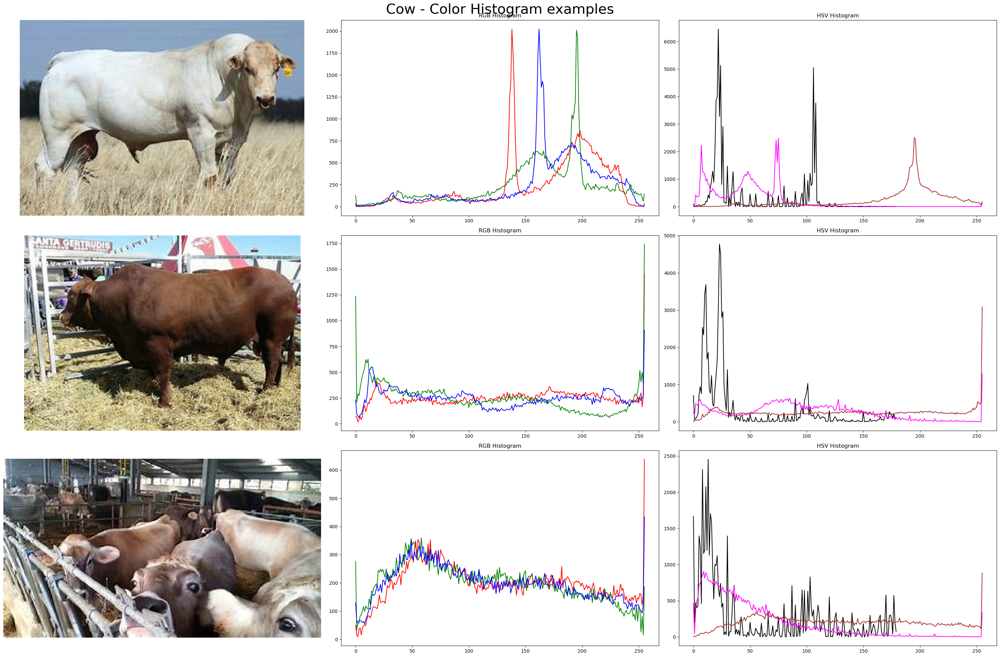

In [10]:
def plot_color_histogram_examples(df, example_label, n_examples=3):
    """"""
    image_samples = df[df['label_name'] == example_label]['img_path'].sample(n_examples, random_state=12345).to_list()
    fig, ax = plt.subplots(nrows=n_examples, ncols=3, figsize=(30, 20))
    for example in range(n_examples):
        rgb_img = load_img_rgb(image_samples[example])
        ax[example, 0].imshow(rgb_img)
        ax[example, 0].axis('off')

        # RGB histogram
        red_hist = cv2.calcHist([rgb_img], [0], None, [256], [0, 256])
        green_hist = cv2.calcHist([rgb_img], [1], None, [256], [0, 256])
        blue_hist = cv2.calcHist([rgb_img], [2], None, [256], [0, 256])
        ax[example, 1].plot(red_hist, color='red')
        ax[example, 1].plot(blue_hist, color='green')
        ax[example, 1].plot(green_hist, color='blue')
        ax[example, 1].set_title('RGB Histogram')

        # HSV histogram
        hsv_img = cv2.cvtColor(rgb_img, cv2.COLOR_RGB2HSV)
        h_hist = cv2.calcHist([hsv_img], [0], None, [180], [0, 180])
        s_hist = cv2.calcHist([hsv_img], [1], None, [256], [0, 256])
        v_hist = cv2.calcHist([hsv_img], [2], None, [256], [0, 256])
        ax[example, 2].plot(h_hist, color='black')
        ax[example, 2].plot(s_hist, color='magenta')
        ax[example, 2].plot(v_hist, color='brown')
        ax[example, 2].set_title('HSV Histogram')
    fig.suptitle(f'{example_label.capitalize()} - Color Histogram examples', fontsize=30)
    fig.tight_layout()
    plt.show()

plot_color_histogram_examples(sample_df, 'cow')


In [11]:
from timeit import default_timer as timer

def color_features(df_row):
    rgb_img = load_img_rgb(df_row['img_path'])
    red_hist = cv2.calcHist([rgb_img], [0], None, [256], [0, 256])
    green_hist = cv2.calcHist([rgb_img], [1], None, [256], [0, 256])
    blue_hist = cv2.calcHist([rgb_img], [2], None, [256], [0, 256])
    df_row['red_mean'] = np.min([np.mean(red_hist), 255])
    df_row['green_mean'] = np.min([np.mean(green_hist), 255])
    df_row['blue_mean'] = np.min([np.mean(blue_hist), 255])

    hsv_img = cv2.cvtColor(rgb_img, cv2.COLOR_RGB2HSV)
    h_hist = cv2.calcHist([hsv_img], [0], None, [180], [0, 180])
    s_hist = cv2.calcHist([hsv_img], [1], None, [256], [0, 256])
    v_hist = cv2.calcHist([hsv_img], [2], None, [256], [0, 256])
    df_row['h_mean'] = np.mean(h_hist)
    df_row['s_mean'] = np.mean(s_hist)
    df_row['v_mean'] = np.mean(v_hist)
    return df_row
    
t0 = timer()
sample_df = sample_df.apply(color_features, axis=1)
sample_df.to_csv('color_features.csv')
print(f'Color features calculated in {timer() - t0}')

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile


Color features calculated in 38.716679541999994


In [ ]:
def plot_color_summaries(df):
    """Plot a histogram of each each of the color statistics by color class """
    color_stat_cols = [['red_mean', 'green_mean', 'blue_mean'], ['h_mean', 's_mean', 'v_mean']]
    fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(10, 10))
    for row in range(len(color_stat_cols)):
        for col in range(len(color_stat_cols[row])):
            stat_name = color_stat_cols[row][col]
            sns.histplot(data=df, x=stat_name, hue='label_name', ax=ax[row, col])
            plt.title(f'{stat_name} Histogram by Label')
            plt.xlabel(stat_name)
            plt.ylabel('count')
    plt.show()

sample_df = pd.read_csv('color_features.csv')
sample_df.head(10)
plot_color_summaries(sample_df)

### Complex feature 1 - ResNet50 etc.

### PCA Decomposition

### tSNE Visualization

# Classification (35 pts)

### Classifier 1

Logisitic regression, SVM, simple perceptron.

### Classifier 2

Logisitic regression, SVM, simple perceptron.

# Results

### Generalization (10 pts)

Split data into train, val, and test groups before training classifier. Use hyper-parameter search to maximize ability to generalize. Discuss how each model did in terms of generalization.

### Efficiency vs Accuracy (10 pts)

For the various combination of three feature vectors and/or classifiers include characterization of accuracy vs computation time and optimize one solution for the best trade off. Include a discussion of trade-off.